#  Object Detection in Aerial Images using DETR

## Part 1 - Data Processing

-----------------------------------


[**DOTA**](https://captain-whu.github.io/DOTA/) is a large-scale dataset for object detection in aerial images. It can be used to develop and evaluate object detectors in aerial images. The images are collected from different sensors and platforms. Each image is of the size in the range from **800 × 800** to **20,000 × 20,000*** pixels and contains objects exhibiting a wide variety of scales, orientations, and shapes.

The instances in DOTA images are annotated by experts in aerial image interpretation by **arbitrary (8 d.o.f.) quadrilateral**. Now it has three versions:

- **DOTA-v1.0** contains 15 common categories, 2,806 images and 188, 282 instances. The proportions of the training set, validation set, and testing set in DOTA-v1.0 are 1/2, 1/6, and 1/3, respectively.
- **DOTA-v1.5** uses the same images as DOTA-v1.0, but the extremely small instances (less than 10 pixels) are also annotated. Moreover, a new category, ”container crane” is added.
- **DOTA-v2.0** collects more Google Earth, GF-2 Satellite, and aerial images. There are 18 common categories, it further adds the new categories of ”airport” and ”helipad”.

Example:

<p align='center'>
<img style="max-width: 1024px" src='https://captain-whu.github.io/DOTA/images/instances-DOTA.jpg' />
</p>

In this tutorial, we will use the version **DOTA-v1.0**. Also, instead of dealing with the oriented object detection (each bounding box is determined by 4 points `(x_i, y_i)`, we will use the label for **horizontal object detection** task (each bounding box is determined by 4 values `x, y, width, height`).

Let's download the data and put them in the following folder structure:

    |- data/
        |- test/
            |- images/
                |- *.jpg
        |- train/
            |- images/
                |- *.jpg
            |- labelTxt/
                |- *.txt
        |- val/
            |- images/
                |- *.jpg
            |- labelTxt/
                |- *.txt
    |- 1_data-processing.ipynb

## 1. Setup development kit

For processing the DOTA dataset, we will use the development kit provided at [this repo](https://github.com/CAPTAIN-WHU/DOTA_devkit). The code provide the following function:
- Load and image, and show the bounding box on it.
- Evaluate the result.
- Split and merge the picture and label.


In [ ]:
!git clone https://github.com/CAPTAIN-WHU/DOTA_devkit

Cloning into 'DOTA_devkit'...
remote: Enumerating objects: 139, done.
remote: Counting objects: 100% (54/54), done.
remote: Compressing objects: 100% (19/19), done.
remote: Total 139 (delta 43), reused 35 (delta 35), pack-reused 85
Receiving objects: 100% (139/139), 59.42 MiB | 6.25 MiB/s, done.
Resolving deltas: 100% (64/64), done.


We have to install some packages to run this script:

In [ ]:
# # Uncomment this cell to run (if necessary)
# !sudo apt-get install swig

In [ ]:
# # Uncomment this cell to run (if necessary)
# %cd DOTA_devkit
# !swig -c++ -python polyiou.i
# !python setup.py build_ext --inplace
# %cd ../

## 2. A demo of using DOTA_devkit

Firstly, we will illustrate the things this development kit do with the data at folder `DOTA_devkit/example`.

Because the DOTA has many extremely large images with thousands pixels per width/height and the sizes of objects are small, we shouldn't resize these images and use them for training. Instead:
- We will **split each image into many patches**. By this step, we will have a new dataset and our model will be trained on it.
- When the training be done, for predicting a test image, we will split it into patches, run the prediction on each patch, then **merge all the patches into a single image** to have the final result.

Luckily, all the functions we need for splitting and merging are defined in this development kit!

### 2.1. Loading the images and annotations

In [ ]:
%matplotlib inline
import sys
sys.path.append('./DOTA_devkit/')
import numpy as np
import matplotlib.pyplot as plt
import os
from DOTA_devkit.DOTA import DOTA
import DOTA_devkit.dota_utils as util
import pylab
pylab.rcParams['figure.figsize'] = (20.0, 20.0)

In [ ]:
example = DOTA('./DOTA_devkit/example')

Let's take a look at some images and their annotations (oriented bounding boxes)

isarralike: False
imgids: ['P0706']
filename: ./DOTA_devkit/example/images/P0706.png
Image's shape: (1182, 1111, 3)
isarralike: False
imgids: ['P0706']
filename: ./DOTA_devkit/example/images/P0706.png


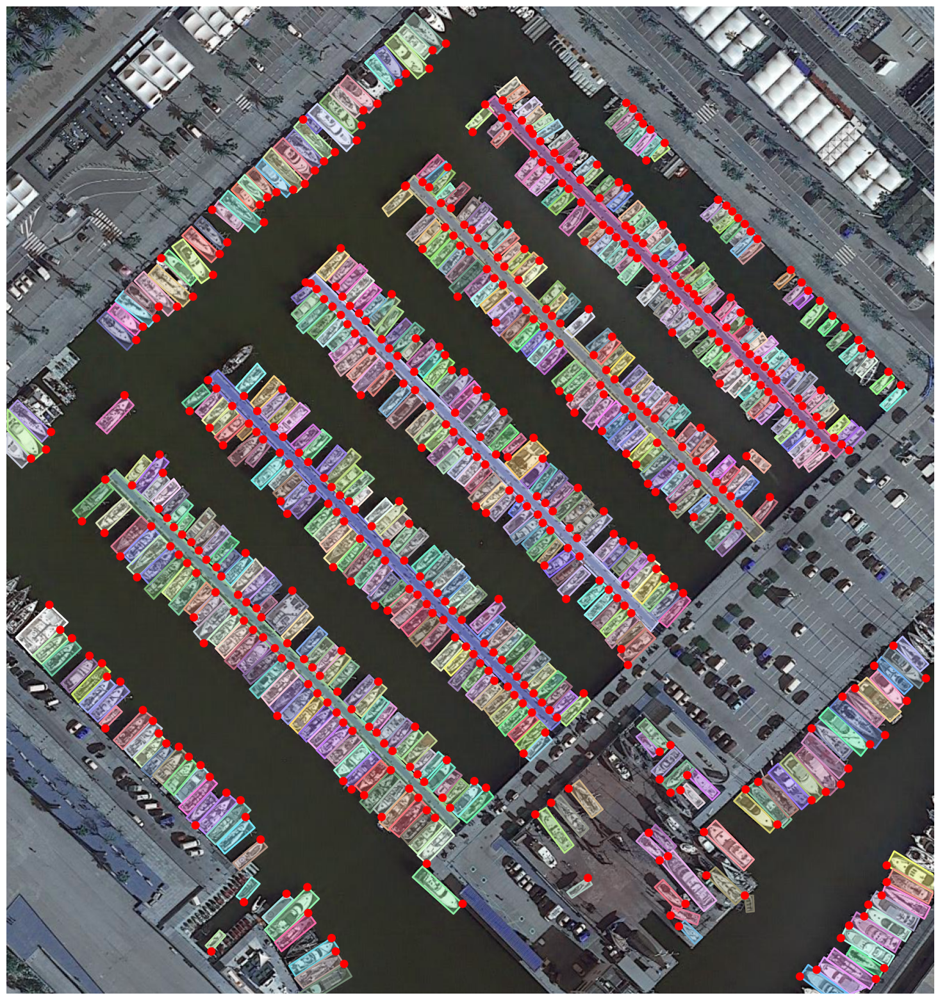

In [ ]:
imgids = example.getImgIds()
imgid = imgids[0]
img = example.loadImgs(imgid)[0]
print('Image\'s shape:', img.shape)
anns = example.loadAnns(imgId=imgid)
example.showAnns(anns, imgid, 2)

isarralike: False
imgids: ['P0770']
filename: ./DOTA_devkit/example/images/P0770.png
Image's shape: (1358, 1610, 3)
isarralike: False
imgids: ['P0770']
filename: ./DOTA_devkit/example/images/P0770.png


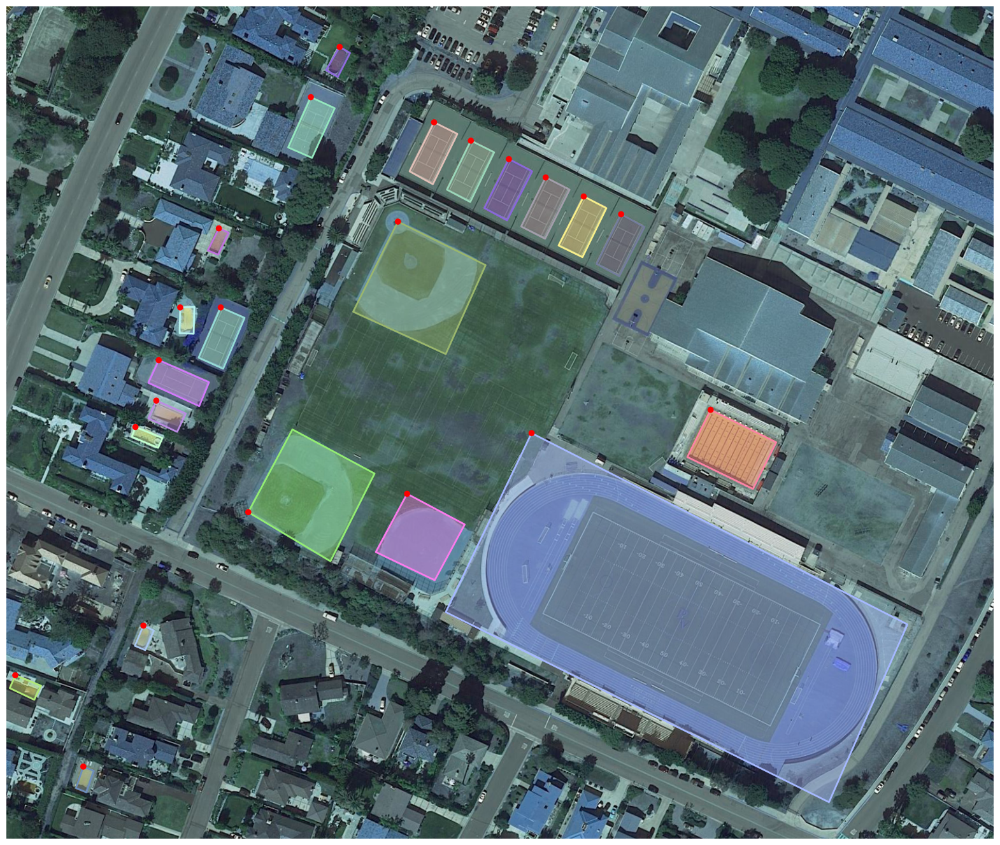

In [ ]:
imgids = example.getImgIds()
imgid = imgids[1]
img = example.loadImgs(imgid)[0]
print('Image\'s shape:', img.shape)
anns = example.loadAnns(imgId=imgid)
example.showAnns(anns, imgid, 2)

### 2.2. Splitting images into patches

For splitting the images into patches, we have a scale parameter. Sometimes, the instance is too large that it can be easily cut down (for example, ground track filed), in such case you need to set the param `rate` less than 1.
- More specifically, the input image will be resize with a scale `rate` before it is splitted

Let's split the images in folder `DOTA_devkit/example` into patches. Notice that the value of `rate` must be in `[0.5, 1, 2]`. Currently, each patch will have width and height not greater than **1024 pixels**.

Note: For test images, you only need to split images, refer to "SplitOnlyImage.py"

In [ ]:
!mkdir ./DOTA_devkit/examplesplit
!mkdir ./DOTA_devkit/examplesplit/images
!mkdir ./DOTA_devkit/examplesplit/labelTxt

In [ ]:
from DOTA_devkit.ImgSplit import splitbase
split = splitbase(r'./DOTA_devkit/example', r'./DOTA_devkit/examplesplit', choosebestpoint=True)
split.splitdata(0.5)

/home/htrvu/anaconda3/envs/htrvu/lib/python3.8/site-packages/shapely/set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)


Example of an original image and its patches:

In [ ]:
examplesplit = DOTA('./DOTA_devkit/examplesplit')

isarralike: False
imgids: ['P1234__0.5__0___976']
filename: ./DOTA_devkit/examplesplit/images/P1234__0.5__0___976.png
Patch's shape: (1024, 1024, 3)
isarralike: False
imgids: ['P1234__0.5__0___976']
filename: ./DOTA_devkit/examplesplit/images/P1234__0.5__0___976.png


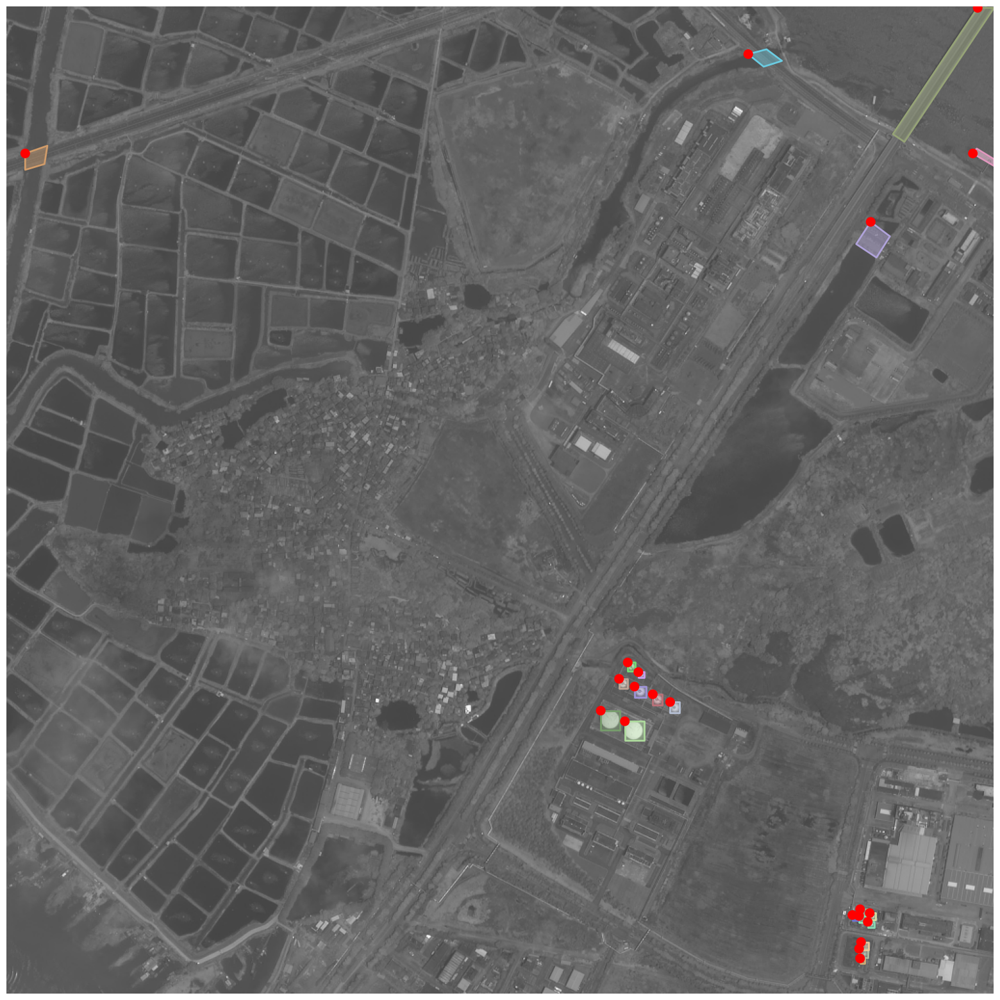

In [ ]:
imgids = examplesplit.getImgIds()
imgid = imgids[10]
img = examplesplit.loadImgs(imgid)[0]
print('Patch\'s shape:', img.shape)
anns = examplesplit.loadAnns(imgId=imgid)
examplesplit.showAnns(anns, imgid, 2)

isarralike: False
imgids: ['P1234__0.5__976___0']
filename: ./DOTA_devkit/examplesplit/images/P1234__0.5__976___0.png
Patch's shape: (1024, 1024, 3)
isarralike: False
imgids: ['P1234__0.5__976___0']
filename: ./DOTA_devkit/examplesplit/images/P1234__0.5__976___0.png


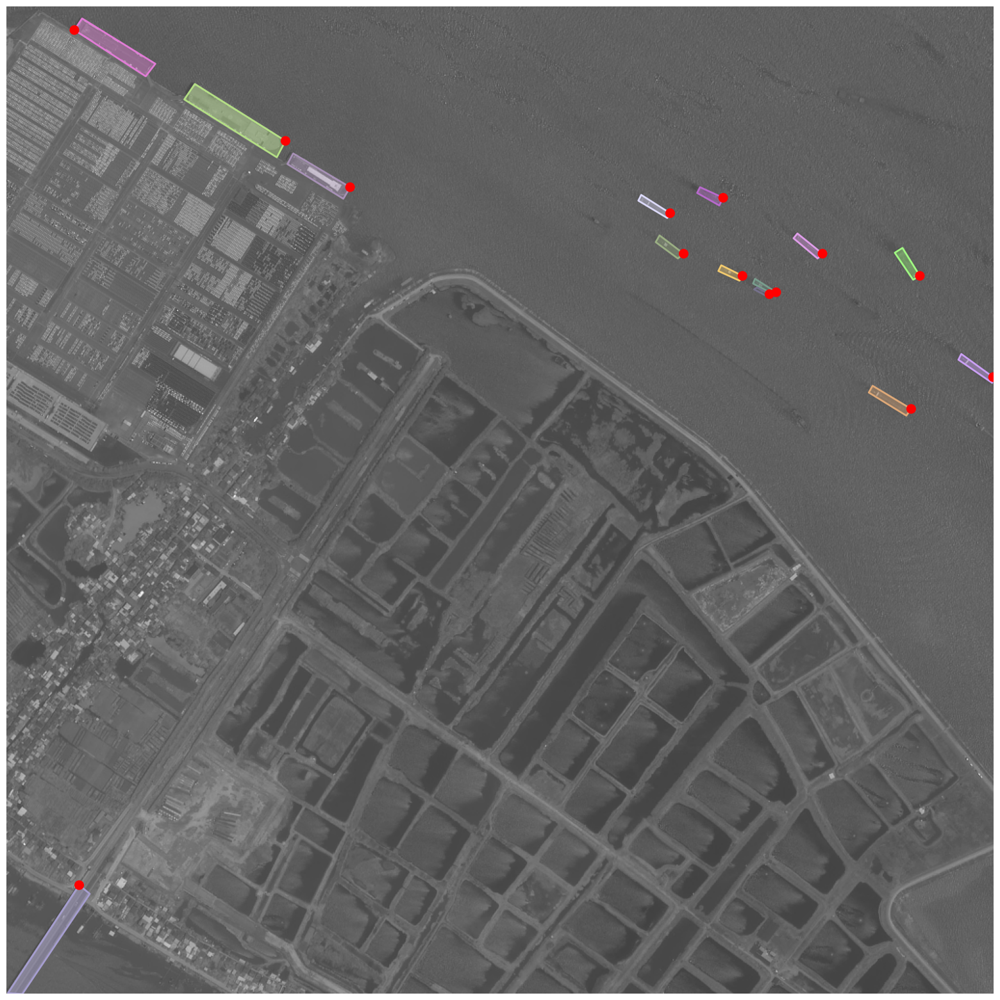

In [ ]:
imgids = examplesplit.getImgIds()
imgid = imgids[20]
img = examplesplit.loadImgs(imgid)[0]
print('Patch\'s shape:', img.shape)
anns = examplesplit.loadAnns(imgId=imgid)
examplesplit.showAnns(anns, imgid, 2)

### 2.3. Merging patches into images
Now, we will merge these patches to see if they can be restored in the initial large images

In [ ]:
from DOTA_devkit.ResultMerge import mergebypoly

In [ ]:
!mkdir ./DOTA_devkit/Task1
!mkdir ./DOTA_devkit/Task1_merge
!mkdir ./DOTA_devkit/restoredexample
!mkdir ./DOTA_devkit/restoredexample/labelTxt

In [ ]:
!cp -r ./DOTA_devkit/example/images ./DOTA_devkit/restoredexample/images

In [ ]:
util.groundtruth2Task1(r'./DOTA_devkit/examplesplit/labelTxt', r'./DOTA_devkit/Task1')
mergebypoly(r'./DOTA_devkit/Task1', r'./DOTA_devkit/Task1_merge')
util.Task2groundtruth_poly(r'./DOTA_devkit/Task1_merge', r'./DOTA_devkit/restoredexample/labelTxt')

In [ ]:
filepath = './DOTA_devkit/example/labelTxt'
imgids = util.GetFileFromThisRootDir(filepath)
imgids = [util.custombasename(x) for x in imgids]
print(imgids)

['P0706', 'P0770', 'P2598', 'P1234', 'P1088', 'P2709', 'P1888']


Original image:

isarralike: False
imgids: ['P2598']
filename: ./DOTA_devkit/example/images/P2598.png


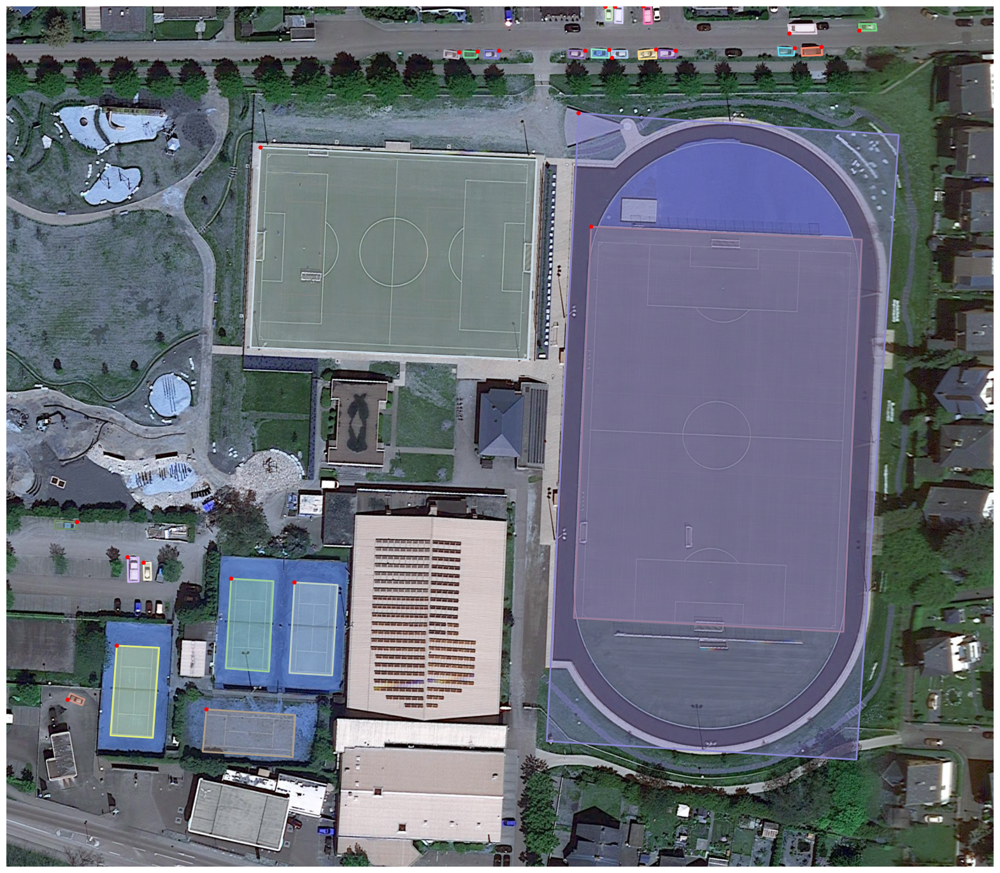

In [ ]:
example = DOTA(r'./DOTA_devkit/example')
num = 2
anns = example.loadAnns(imgId=imgids[num])
example.showAnns(anns, imgids[num], 1)

Merging result:

isarralike: False
imgids: ['P2598']
filename: ./DOTA_devkit/restoredexample/images/P2598.png


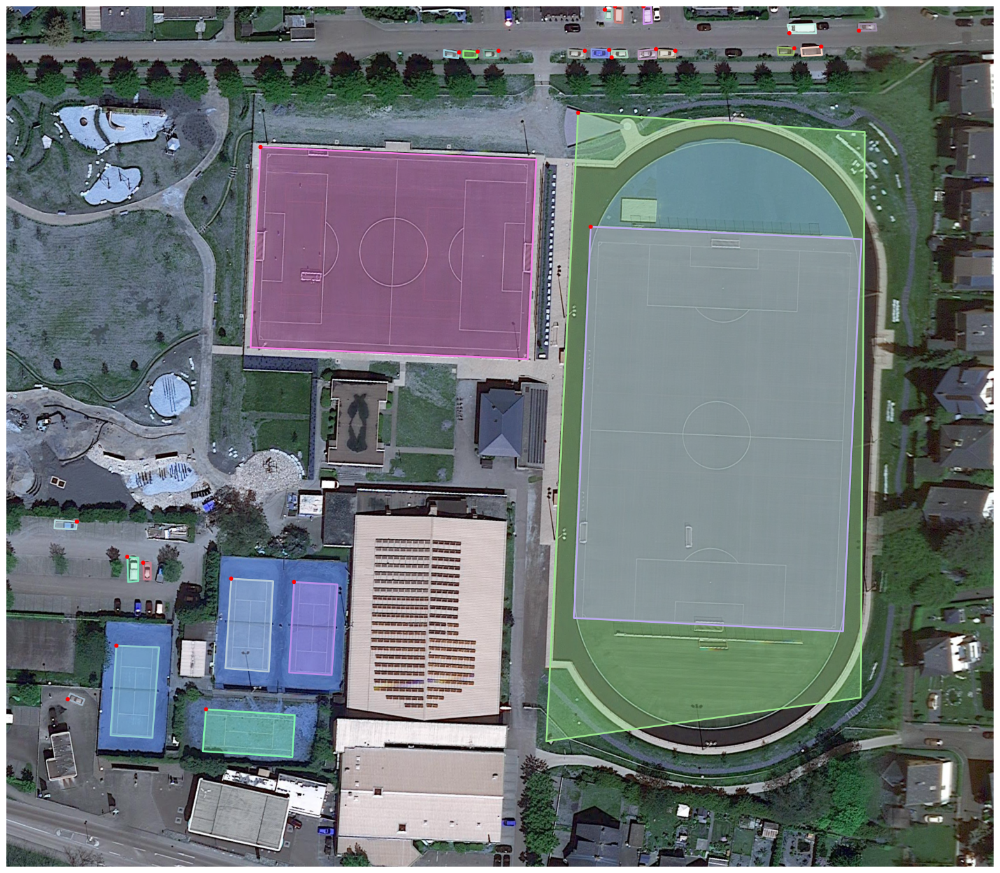

In [ ]:
restored = DOTA(r'./DOTA_devkit/restoredexample')
num = 2
anns = restored.loadAnns(imgId=imgids[num])
restored.showAnns(anns, imgids[num], 2)

### 3. Generating dataset in COCO format

For later training, we need to generate a COCO format version of this dataset. The development kit also have a function to do that!

Currently, the annotaion for each object in the output file will be similar to the following dictionary:

```python
{
    "area": 45.0,
    "category_id": 5,
    "segmentation": [
        [
            337,
            187,
            341,
            187,
            342,
            197,
            337,
            197
        ]
    ],
    "iscrowd": 0,
    "bbox": [
        337,
        187,
        5,
        10
    ],
    "image_id": 1,
    "id": 1
},
```

As mentioned before, we will train the model to predict horizontal bounding boxes (with `x, y, width, height` values). Therefore, we will remove the `segmentation` key in the annotation of all objects.

In [ ]:
from DOTA_devkit.DOTA2COCO import DOTA2COCO
DOTA2COCO('./DOTA_devkit/examplesplit/', './DOTA_devkit/examplesplit/examplecoco.json')

In [ ]:
import json
with open('./DOTA_devkit/examplesplit/examplecoco.json') as f:
    data = json.load(f)
anns = data['annotations']
for ann in anns:
    ann.pop('segmentation', None)
    ann['area'] = ann['bbox'][2] * ann['bbox'][3]
with open('./DOTA_devkit/examplesplit/examplecoco.json', 'w') as f:
    json.dump(data, f)

Let's print out an annotation:

In [ ]:
with open('./DOTA_devkit/examplesplit/examplecoco.json') as f:
    data = json.load(f)
anns = data['annotations']
anns[0]

{'area': 50,
 'category_id': 5,
 'iscrowd': 0,
 'bbox': [337, 187, 5, 10],
 'image_id': 1,
 'id': 1}

## 3. Process the original data

Here, we will combine all the steps above to process our original data. For later use, the COCO folder will be in the following structure:

```
|- dota-coco/
    |- annotations
        |- custom_train.json
        |- custom_val.json
    |- train2017/
        |- *.jpg
    |- val2017/
        |- *.jpg
```

In [ ]:
!mkdir dota-coco
!mkdir dota-coco/annotations

In [ ]:
import shutil

def process(src_folder='./train', img_dst_folder='./dota-coco/train2017', anns_dst_path='./dota-coco/annotations/custom_train.json', split_rate=0.5):
    # split images into patches
    splitted_data_folder = os.path.join(src_folder, 'images_splitted') 
    if not os.path.exists(splitted_data_folder):
        os.mkdir(splitted_data_folder)
        os.mkdir(os.path.join(splitted_data_folder, 'images'))
        os.mkdir(os.path.join(splitted_data_folder, 'labelTxt'))

        split = splitbase(src_folder, splitted_data_folder, choosebestpoint=True)
        split.splitdata(split_rate)    # you can change the rate (if necessary)

    # generate and modify coco json file
    DOTA2COCO(splitted_data_folder, anns_dst_path)
    with open(anns_dst_path) as f:
        data = json.load(f)
    anns = data['annotations']
    for ann in anns:
        ann.pop('segmentation', None)
        ann['area'] = ann['bbox'][2] * ann['bbox'][3]
    with open(anns_dst_path, 'w') as f:
        json.dump(data, f)

    # move the images folder
    shutil.move(os.path.join(splitted_data_folder, 'images'), img_dst_folder)

In [ ]:
process(src_folder='./data/val/', img_dst_folder='./dota-coco/val2017', anns_dst_path='./dota-coco/annotations/custom_val.json')

/home/htrvu/anaconda3/envs/htrvu/lib/python3.8/site-packages/shapely/set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)


In [ ]:
process(src_folder='./data/train/', img_dst_folder='./dota-coco/train2017', anns_dst_path='./dota-coco/annotations/custom_train.json')

And now, we have done the data processing step!

In [ ]:
%ls dota-coco

annotations/  train2017/  val2017/


In [ ]:
%ls dota-coco/annotations

custom_train.json  custom_val.json
